# Distribution of components of the Human Development Index (HDI) in the districts of the city of São Paulo

This analysis uses the database taken from the "IDHM 2000 e 2010" database.

Link to the database: http://dados.prefeitura.sp.gov.br/pt_PT/dataset/indice-de-desenvolvimento-humano-municipal/resource/8d7de997-68ae-4d0b-a383-d594ca48ec71 (last accessed at 2023-10-11)

In [1]:
import geopandas as gpd
import os

if 'spatial' in os.getcwd():
    data_folder = '../../data/'
elif 'data_analysis' in os.getcwd():
    data_folder = '../data/'
else:
    data_folder = './data/'

source_folder_path = data_folder + 'infrastructure/'
destination_folder_path = data_folder + 'income/maps/'

In [2]:
zone_shp = gpd.read_file(source_folder_path + 'shapes/Distritos_2017_region.shp')
zone_shp.crs = {'init': 'epsg:31983'}  
zone_shp.to_crs(epsg='4326', inplace=True)
zone_shp

/home/oem/.local/lib/python3.10/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


,NumeroDist,NomeDistri,Area_ha,geometry
0,1,Água Rasa,715.05,"POLYGON Z ((-46.55380 -23.56843 0.00000, -46.5..."
1,2,Alto de Pinheiros,751.26,"POLYGON Z ((-46.69209 -23.54631 0.00000, -46.6..."
2,3,Anhanguera,3339.95,"POLYGON Z ((-46.76082 -23.42733 0.00000, -46.7..."
3,4,Aricanduva,686.26,"POLYGON Z ((-46.50153 -23.57941 0.00000, -46.5..."
4,5,Artur Alvim,653.04,"POLYGON Z ((-46.47300 -23.54029 0.00000, -46.4..."
...,...,...,...,...
129,130,São Caetano do Sul,1536.53,"POLYGON Z ((-46.58317 -23.64088 0.00000, -46.5..."
130,131,São Lourenço da Serra,18674.34,"POLYGON Z ((-46.98852 -23.79984 0.00000, -46.9..."
131,132,Suzano,20666.94,"POLYGON Z ((-46.38321 -23.61775 0.00000, -46.3..."
132,133,Taboão da Serra,2043.37,"POLYGON Z ((-46.81819 -23.63701 0.00000, -46.8..."


In [3]:
districts_city_sp = [
    'Bela Vista', 'Bom Retiro', 'Cambuci', 'Consolação', 'Liberdade', 
    'República', 'Santa Cecília', 'Sé','Butantã', 'Morumbi', 'Raposo Tavares', 
    'Rio Pequeno', 'Vila Sônia', 'Barra Funda', 'Jaguara', 'Jaguaré', 'Lapa', 
    'Perdizes', 'Vila Leopoldina', 'Alto de Pinheiros', 'Itaim Bibi', 
    'Jardim Paulista', 'Pinheiros','Aricanduva', 'Carrão', 'Vila Formosa',
    'Água Rasa', 'Belém', 'Brás', 'Mooca', 'Pari', 'Tatuapé', 'Artur Alvim',
    'Cangaíba', 'Penha', 'Vila Matilde', 'São Lucas', 'Sapopemba',
    'Vila Prudente','Cidade Tiradentes', 'Ermelino Matarazzo', 'Ponte Rasa',
    'Guaianases', 'Lajeado', 'Itaim Paulista', 'Vila Curuçá', 'Cidade Líder',
    'Itaquera', 'José Bonifácio', 'Parque do Carmo', 'Iguatemi', 'São Mateus',
    'São Rafael', 'Jardim Helena', 'São Miguel', 'Vila Jacuí','Cachoeirinha', 
    'Casa Verde', 'Limão', 'Brasilândia', 'Freguesia do Ó', 'Anhanguera', 
    'Perus', 'Jaraguá', 'Pirituba', 'São Domingos','Jaçanã', 'Tremembé', 
    'Mandaqui', 'Santana', 'Tucuruvi', 'Vila Guilherme', 'Vila Maria', 
    'Vila Medeiros','Cursino', 'Ipiranga', 'Sacomã', 'Jabaquara', 'Moema', 
    'Saúde', 'Vila Mariana', 'Campo Limpo', 'Capão Redondo', 'Vila Andrade', 
    'Cidade Dutra', 'Grajaú', 'Socorro', 'Cidade Ademar', 'Pedreira', 
    'Jardim Ângela', 'Jardim São Luís', 'Marsilac', 'Parelheiros',
    'Campo Belo', 'Campo Grande', 'Santo Amaro']

In [4]:
#read data

zone_shp['NumeroZona'] = zone_shp['NumeroDist']
zone_shp['NomeZona'] = zone_shp['NomeDistri']
zone_shp['NumeroMuni'] = 0

numeroMuni = []
for _, d in zone_shp.iterrows():
    if d['NomeDistri'] in districts_city_sp:
        numeroMuni.append(36)
    else:
        numeroMuni.append(0)
zone_shp['NumeroMuni'] = numeroMuni

display(zone_shp)


,NumeroDist,NomeDistri,Area_ha,geometry,NumeroZona,NomeZona,NumeroMuni
0,1,Água Rasa,715.05,"POLYGON Z ((-46.55380 -23.56843 0.00000, -46.5...",1,Água Rasa,36
1,2,Alto de Pinheiros,751.26,"POLYGON Z ((-46.69209 -23.54631 0.00000, -46.6...",2,Alto de Pinheiros,36
2,3,Anhanguera,3339.95,"POLYGON Z ((-46.76082 -23.42733 0.00000, -46.7...",3,Anhanguera,36
3,4,Aricanduva,686.26,"POLYGON Z ((-46.50153 -23.57941 0.00000, -46.5...",4,Aricanduva,36
4,5,Artur Alvim,653.04,"POLYGON Z ((-46.47300 -23.54029 0.00000, -46.4...",5,Artur Alvim,36
...,...,...,...,...,...,...,...
129,130,São Caetano do Sul,1536.53,"POLYGON Z ((-46.58317 -23.64088 0.00000, -46.5...",130,São Caetano do Sul,0
130,131,São Lourenço da Serra,18674.34,"POLYGON Z ((-46.98852 -23.79984 0.00000, -46.9...",131,São Lourenço da Serra,0
131,132,Suzano,20666.94,"POLYGON Z ((-46.38321 -23.61775 0.00000, -46.3...",132,Suzano,0
132,133,Taboão da Serra,2043.37,"POLYGON Z ((-46.81819 -23.63701 0.00000, -46.8...",133,Taboão da Serra,0


In [5]:
zone_shp_sp = zone_shp[zone_shp['NumeroMuni'] == 36]
zone_shp_sp

,NumeroDist,NomeDistri,Area_ha,geometry,NumeroZona,NomeZona,NumeroMuni
0,1,Água Rasa,715.05,"POLYGON Z ((-46.55380 -23.56843 0.00000, -46.5...",1,Água Rasa,36
1,2,Alto de Pinheiros,751.26,"POLYGON Z ((-46.69209 -23.54631 0.00000, -46.6...",2,Alto de Pinheiros,36
2,3,Anhanguera,3339.95,"POLYGON Z ((-46.76082 -23.42733 0.00000, -46.7...",3,Anhanguera,36
3,4,Aricanduva,686.26,"POLYGON Z ((-46.50153 -23.57941 0.00000, -46.5...",4,Aricanduva,36
4,5,Artur Alvim,653.04,"POLYGON Z ((-46.47300 -23.54029 0.00000, -46.4...",5,Artur Alvim,36
...,...,...,...,...,...,...,...
91,92,Vila Mariana,854.26,"MULTIPOLYGON Z (((-46.61397 -23.58178 0.00000,...",92,Vila Mariana,36
92,93,Vila Matilde,891.87,"POLYGON Z ((-46.49321 -23.54323 0.00000, -46.4...",93,Vila Matilde,36
93,94,Vila Medeiros,789.39,"POLYGON Z ((-46.55971 -23.48960 0.00000, -46.5...",94,Vila Medeiros,36
94,95,Vila Prudente,960.19,"POLYGON Z ((-46.55011 -23.60034 0.00000, -46.5...",95,Vila Prudente,36


<AxesSubplot:>

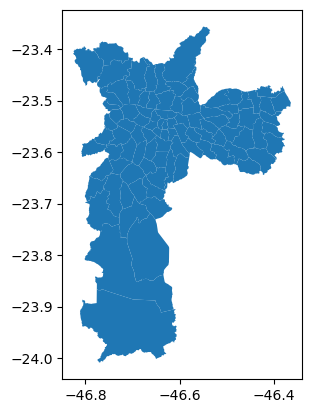

In [6]:
zone_shp_sp.plot()

In [7]:
import pandas as pd
pd.set_option('display.max_columns', None)
pd.options.mode.chained_assignment = None  # default='warn'
source_folder_path_income = data_folder + 'income/'
filename = 'deinfoidhudh20002010dados.csv'

IDHM_data = pd.read_csv(source_folder_path_income + filename, encoding = "ISO-8859-1", sep = ',')
IDHM_data

,Cod_ID,NOME_UDH,CODMUN6,NOME_MUN,CODUF,NOME_UF,CODRM,NOME_RM,ANO,ESPVIDA,FECTOT,MORT1,MORT5,SOBRE40,SOBRE60,RAZDEP,T_ENV,E_ANOSESTUDO,T_ANALF11A14,T_ANALF15A17,T_ANALF15M,T_ANALF18A24,T_ANALF18M,T_ANALF25A29,T_ANALF25M,T_ATRASO_2_BASICO,T_ATRASO_2_FUND,T_FBBAS,T_FBFUND,T_FBMED,T_FBSUPER,T_FLBAS,T_FLFUND,T_FLMED,T_FLSUPER,T_FREQ0A5,T_FREQ15A17,T_FREQ18A24,T_FREQ25A29,T_FREQ5A6,T_FREQ6A14,T_FREQ6A17,T_FREQFUND1517,T_FREQFUND1824,T_FREQMED1824,T_FUND11A13,T_FUND15A17,T_FUND18A24,T_FUND18M,T_FUND25M,T_MED18A20,T_MED18A24,T_MED18M,T_MED25M,T_SUPER25M,CORTE1,CORTE2,CORTE3,CORTE4,CORTE9,GINI,PIND,PINDCRI,PMPOB,PMPOBCRI,PPOB,PPOBCRI,PREN10RICOS,PREN20,PREN20RICOS,PREN40,PREN60,PREN80,PRENTRAB,R1040,R2040,RDPC,RDPC1,RDPC10,RDPC2,RDPC3,RDPC4,RDPC5,RDPCT,RIND,RMPOB,RPOB,THEIL,P_AGRO,P_COM,P_CONSTR,P_EXTR,P_SERV,P_SIUP,P_TRANSF,CPR,EMP,P_FORMAL,TRABCC,TRABPUB,TRABSC,P_FUND,P_MED,P_SUPER,REN0,REN1,REN2,REN3,REN5,RENOCUP,THEILtrab,T_ATIV,T_ATIV1014,T_ATIV1517,T_ATIV1824,T_ATIV18M,T_ATIV2529,T_DES,T_DES1014,T_DES1517,T_DES1824,T_DES18M,T_DES2529,T_AGUA,T_BANAGUA,T_DENS,T_LIXO,T_LUZ,AGUA_ESGOTO,PAREDE,T_CRIFUNDIN_TODOS,T_FORA0A5,T_FORA6A14,T_FUNDIN_TODOS,T_FUNDIN_TODOS_MMEIO,T_FUNDIN18MINF,T_M10A17CF,T_MULCHEFEFIF014,T_NESTUDA_NTRAB_MMEIO,T_OCUPDESLOC_1,T_RMAXIDOSO,T_SLUZ,T_VULNERA_NESTUDA_NTRAB_MMEIO,T_VULNERA_MULCHEFE,T_VULNERA_RMAXIDOSO,T_VULNERA_OCUPDESLOC_13,HOMEM0A4,HOMEM10A14,HOMEM15A19,HOMEM20A24,HOMEM25A29,HOMEM30A34,HOMEM35A39,HOMEM40A44,HOMEM45A49,HOMEM50A54,HOMEM55A59,HOMEM5A9,HOMEM60A64,HOMEM65A69,HOMEM70A74,HOMEM75A79,HOMENS80,HOMEMTOT,MULH0A4,MULH10A14,MULH15A19,MULH20A24,MULH25A29,MULH30A34,MULH35A39,MULH40A44,MULH45A49,MULH50A54,MULH55A59,MULH5A9,MULH60A64,MULH65A69,MULH70A74,MULH75A79,MULHER80,MULHERTOT,PEA,PEA1014,PEA1517,PEA18M,PESO1,PESO1114,PESO1113,PESO1214,PESO13,PESO15,PESO1517,PESO1524,PESO1618,PESO18,PESO1820,PESO1824,PESO1921,PESO25,PESO4,PESO5,PESO6,PESO610,PESO617,PESO65,PESOM1014,PESOM1517,PESOM15M,PESOM25M,PESORUR,PESOTOT,PESOURB,PIA,PIA1014,PIA1517,PIA18M,POP,T_FBFUND_tudo,T_FBMED_tudo,T_FBBAS_tudo,T_FLFUND_tudo,T_FLMED_tudo,T_FLBAS_tudo,T_FUND11A13_tudo,I_ESCOLARIDADE,I_FREQ_PROP,IDHM,IDHM_E,IDHM_L,IDHM_R,CODDIST,DISTRITO,REGIAO8,SUBPREF
0,1355030801001,Jardim Anália Franco / Vila Formosa : Hospital...,355030,São Paulo (SP),35,SP,63500,RM São Paulo (SP),2000,76.57,1.31,12.3,14.31,94.77,85.80,42.02,10.87,11.49,0.25,0.66,2.35,0.37,2.46,0.80,2.86,5.63,2.91,104.75,104.00,106.73,37.85,94.29,96.25,72.57,29.14,49.90,90.08,41.57,8.33,91.21,98.68,96.31,13.61,1.72,8.66,92.35,76.03,86.61,65.91,61.88,61.31,67.50,49.74,46.29,17.00,488.02,847.21,1335.23,2337.63,3416.16,0.47,0.21,0.65,0.64,1.63,4.01,7.20,33.57,4.22,51.53,12.53,26.43,48.47,85.52,10.72,8.22,1562.09,329.29,5244.36,649.43,1085.64,1721.35,4024.75,1562.09,39.04,79.05,165.76,0.39,0.14,24.73,4.16,0.10,54.47,0.59,15.12,27.42,10.67,66.06,38.37,6.19,15.34,78.71,62.30,21.71,2.02,9.40,29.63,41.97,63.89,2949.60,0.46,NaN,1.39,33.48,82.65,66.32,83.40,NaN,72.60,24.09,16.64,11.16,12.57,100.00,99.70,20.64,100.00,100.0,0.0,NaN,7.04,50.10,1.32,12.01,1.28,27.35,0.80,29.23,1.11,NaN,1.53,0.0,47.17,1.90,100.00,NaN,578,722,873,846,765,762,792,727,615,537,416,579,359,301,273,172,105,9419,550,722,813,909,851,797,892,819,742,625,531,606,461,445,387,267,231,10644,NaN,20.0,330.0,10161.0,213,1188,880,904,667,16308,987,3440,1044,15321,1042,2454,1075,12868,248,248,196,1192,3366,2180,722,461,8767,7045,0,20062,20062,17752.0,1444.0,987.0,15321.0,20013.0,108.60,115.50,110.49,99.02,75.18,96.55,96.92,0.659,0.802,0.818,0.751,0.860,0.848,85,Vila Formosa,Leste 1,Aricanduva/Formosa/Carrão
1,1355030801002,Vila Califórnia,355030,São Paulo (SP),35,SP,63500,RM São Paulo (SP),2000,76.78,1.32,12.0,13.97,94.89,86.09,43.84,11.97,11.52,0.74,0.63,2.51,0.63,2.62,1.45,2.97,7.12,2.23,101.93,106.80,89.23,41.99,93.13,96.08,63.85,25.99,45.46,91.88,43.79,11.10,91.07,99.26,97.22,19.23,2.51,8.26,87.00,70.65,79.94,65.65,63.20,49.02,57.73,50.44,49.19,20.56,531.40,902.84,1399.65,2342.51,3448.69,0.47,NaN,NaN,0.36,0.27,4.1

In [8]:
list_dist1 = list(set(IDHM_data['DISTRITO'].unique()))
list_dist1.sort()
list_dist2 = list(set(zone_shp_sp['NomeZona'].unique()))
list_dist2.sort()

In [9]:
list_dist1 == list_dist2

False

In [10]:
for i in range(len(list_dist1)):
    if list_dist1[i] != list_dist2[i]:
        print(i)
        print('-'+ list_dist1[i]+'-')
        print('-'+list_dist2[i]+'-')


52
-Morumbi-
-Mooca-
53
-Moóca-
-Morumbi-
77
-São Miguel -
-São Miguel-


So I need to remove the spaces before and after the strings and remove the pontuaction in 'Moóca'

In [11]:
district_column = 'DISTRITO'

In [12]:
IDHM_data[district_column] = IDHM_data[district_column].replace('Moóca', 'Mooca')

In [13]:
IDHM_data[district_column] = IDHM_data[district_column].str.strip()

In [14]:
list_dist1 = list(set(IDHM_data[district_column].unique()))
list_dist1.sort()
list_dist2 = list(set(zone_shp_sp['NomeZona'].unique()))
list_dist2.sort()

In [15]:
list_dist1 == list_dist2

True

Now I can associate both dataframes using the districts

I want to use the column RDPC, which shows the average per capita income

Thus, I need to group the IDHM data using the districts column and calculate the average of RDPC in each district - and then add a column with this data in the zone_shp_sp

In [16]:
grouped = IDHM_data.groupby(district_column).mean()
grouped

/tmp/ipykernel_8637/3030235489.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  grouped = IDHM_data.groupby(district_column).mean()


,Cod_ID,CODMUN6,CODUF,CODRM,ANO,ESPVIDA,FECTOT,MORT1,MORT5,SOBRE40,SOBRE60,RAZDEP,T_ENV,E_ANOSESTUDO,T_ANALF11A14,T_ANALF15A17,T_ANALF15M,T_ANALF18A24,T_ANALF18M,T_ANALF25A29,T_ANALF25M,T_ATRASO_2_BASICO,T_ATRASO_2_FUND,T_FBBAS,T_FBFUND,T_FBMED,T_FBSUPER,T_FLBAS,T_FLFUND,T_FLMED,T_FLSUPER,T_FREQ0A5,T_FREQ15A17,T_FREQ18A24,T_FREQ25A29,T_FREQ5A6,T_FREQ6A14,T_FREQ6A17,T_FREQFUND1517,T_FREQFUND1824,T_FREQMED1824,T_FUND11A13,T_FUND15A17,T_FUND18A24,T_FUND18M,T_FUND25M,T_MED18A20,T_MED18A24,T_MED18M,T_MED25M,T_SUPER25M,CORTE1,CORTE2,CORTE3,CORTE4,CORTE9,GINI,PIND,PINDCRI,PMPOB,PMPOBCRI,PPOB,PPOBCRI,PREN10RICOS,PREN20,PREN20RICOS,PREN40,PREN60,PREN80,PRENTRAB,R1040,R2040,RDPC,RDPC1,RDPC10,RDPC2,RDPC3,RDPC4,RDPC5,RDPCT,RIND,RMPOB,RPOB,THEIL,P_AGRO,P_COM,P_CONSTR,P_EXTR,P_SERV,P_SIUP,P_TRANSF,CPR,EMP,P_FORMAL,TRABCC,TRABPUB,TRABSC,P_FUND,P_MED,P_SUPER,REN0,REN1,REN2,REN3,REN5,RENOCUP,THEILtrab,T_ATIV,T_ATIV1014,T_ATIV1517,T_ATIV1824,T_ATIV18M,T_ATIV2529,T_DES,T_DES1014,T_DES1517,T_DES1824,T_DES18M,T_DES2529,T_AGUA,T_BANAGUA,T_DENS,T_LIXO,T_LUZ,AGUA_ESGOTO,PAREDE,T_CRIFUNDIN_TODOS,T_FORA0A5,T_FORA6A14,T_FUNDIN_TODOS,T_FUNDIN_TODOS_MMEIO,T_FUNDIN18MINF,T_M10A17CF,T_MULCHEFEFIF014,T_NESTUDA_NTRAB_MMEIO,T_OCUPDESLOC_1,T_RMAXIDOSO,T_SLUZ,T_VULNERA_NESTUDA_NTRAB_MMEIO,T_VULNERA_MULCHEFE,T_VULNERA_RMAXIDOSO,T_VULNERA_OCUPDESLOC_13,HOMEM0A4,HOMEM10A14,HOMEM15A19,HOMEM20A24,HOMEM25A29,HOMEM30A34,HOMEM35A39,HOMEM40A44,HOMEM45A49,HOMEM50A54,HOMEM55A59,HOMEM5A9,HOMEM60A64,HOMEM65A69,HOMEM70A74,HOMEM75A79,HOMENS80,HOMEMTOT,MULH0A4,MULH10A14,MULH15A19,MULH20A24,MULH25A29,MULH30A34,MULH35A39,MULH40A44,MULH45A49,MULH50A54,MULH55A59,MULH5A9,MULH60A64,MULH65A69,MULH70A74,MULH75A79,MULHER80,MULHERTOT,PEA,PEA1014,PEA1517,PEA18M,PESO1,PESO1114,PESO1113,PESO1214,PESO13,PESO15,PESO1517,PESO1524,PESO1618,PESO18,PESO1820,PESO1824,PESO1921,PESO25,PESO4,PESO5,PESO6,PESO610,PESO617,PESO65,PESOM1014,PESOM1517,PESOM15M,PESOM25M,PESORUR,PESOTOT,PESOURB,PIA,PIA1014,PIA1517,PIA18M,POP,T_FBFUND_tudo,T_FBMED_tudo,T_FBBAS_tudo,T_FLFUND_tudo,T_FLMED_tudo,T_FLBAS_tudo,T_FUND11A13_tudo,I_ESCOLARIDADE,I_FREQ_PROP,IDHM,IDHM_E,IDHM_L,IDHM_R,CODDIST
DISTRITO,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Alto de Pinheiros,1.355031e+12,355030.0,35.0,63500.0,2005.0,79.890000,1.185000,8.300000,9.660000,96.570000,89.985000,39.440000,14.480000,11.400000,0.285000,0.340000,0.825000,0.410000,0.850000,0.495000,0.920000,5.545000,4.920000,97.295000,100.920000,88.340000,86.055000,86.695000,89.895000,66.015000,46.535000,57.460000,90.425000,58.435000,19.390000,96.660000,98.350000,96.045000,8.500000,1.740000,4.485000,85.190000,84.305000,89.695000,85.190000,84.490000,70.520000,76.370000,75.745000,75.535000,52.920000,1154.075000,2323.650000,4228.290000,6623.345000,9715.515000,0.515000,0.195000,0.770000,0.460000,1.510000,1.440000,1.565000,38.160000,2.850000,54.585000,10.195000,23.515000,45.415000,73.555000,14.970000,10.705000,4808.720000,683.750000,18384.980000,1767.940000,3203.565000,5262.860000,13125.490000,4808.720000,28.910000,40.855000,177.755000,0.520000,0.595000,11.425000,2.580000,0.110000,68.590000,0.645000,8.225000,28.635000,12.145000,72.935000,43.985000,3.770000,10.195000,92.835000,86.765000,62.620000,1.415000,3.695000,15.705000,22.525000,37.955000,6644.030000,0.570000,NaN,3.520000,16.605000,58.615000,66.710000,84.625000,NaN,74.395000,31.005000,13.110000,5.525000,4.960000,99.985000,97.520000,9.515000,99.815000,100.000000,0.000000,0.000000,4.615000,42.540000,1.650000,4.170000,0.340000,9.470000,0.570000,11.110000,0.325000,0.000000,0.305000,0.000000,24.050000,3.590000,100.000000,0.000000,915.000000,1173.500000,1369.500000,1664.000000,1603.500000,1521.000000,1438.500000,1376.500000,1444.000000,1301.000000,1186.500000,994.500000,1062.500000,844.500000,752.500000,485.000000,483.500000,19615.500000,906.000000,1096.

In [17]:
grouped['RDPC']

DISTRITO
Alto de Pinheiros    4808.720000
Anhanguera            502.088333
Aricanduva           1096.777308
Artur Alvim           740.883750
Barra Funda          2195.915000
                        ...     
Vila Matilde         1080.815000
Vila Medeiros         682.846333
Vila Prudente        1184.499189
Vila Sônia           1701.218235
Água Rasa            1284.001429
Name: RDPC, Length: 96, dtype: float64

In [18]:
zone_shp_sp = zone_shp_sp.join(grouped, on='NomeZona')

In [19]:
zone_shp_sp[['NomeZona', 'RDPC']]

,NomeZona,RDPC
0,Água Rasa,1284.001429
1,Alto de Pinheiros,4808.720000
2,Anhanguera,502.088333
3,Aricanduva,1096.777308
4,Artur Alvim,740.883750
...,...,...
91,Vila Mariana,3701.900000
92,Vila Matilde,1080.815000
93,Vila Medeiros,682.846333
94,Vila Prudente,1184.499189


In [20]:
from modules.BikeScience import BikeScience
bs = BikeScience()

In [21]:
tooltip_columns = ['NomeZona', 'RDPC']
tooltip_aliases = ['Distrito','RDPC']

fmap = bs.map_around_sp(the_grid = '', plot_grid=False, zoom = 11, north_offset=.12, east_offset=.4)
bs.plot_zones(fmap, zone_shp_sp, 'RDPC', 'Blues')
bs.plot_zones_tooltip(fmap, zone_shp_sp, tooltip_columns, tooltip_aliases)

from branca.element import Figure
fig = Figure(width=800, height=1100)
fig.add_child(fmap)

In [22]:
fmap.save(destination_folder_path + 'average_income.html')

In [23]:
tooltip_columns = ['NomeZona', 'ESPVIDA']
tooltip_aliases = ['Distrito','ESPVIDA']

fmap = bs.map_around_sp(the_grid = '', plot_grid=False, zoom = 11, north_offset=.12, east_offset=.4)
bs.plot_zones(fmap, zone_shp_sp, 'ESPVIDA', 'Blues')
bs.plot_zones_tooltip(fmap, zone_shp_sp, tooltip_columns, tooltip_aliases)

from branca.element import Figure
fig = Figure(width=800, height=1100)
fig.add_child(fmap)

In [24]:
fmap.save(destination_folder_path + 'life_expectancy.html')

In [25]:
tooltip_columns = ['NomeZona', 'P_MED']
tooltip_aliases = ['Distrito','P_MED']

fmap = bs.map_around_sp(the_grid = '', plot_grid=False, zoom = 11, north_offset=.12, east_offset=.4)
bs.plot_zones(fmap, zone_shp_sp, 'P_MED', 'Blues')
bs.plot_zones_tooltip(fmap, zone_shp_sp, tooltip_columns, tooltip_aliases)

from branca.element import Figure
fig = Figure(width=800, height=1100)
fig.add_child(fmap)

In [26]:
fmap.save(destination_folder_path + 'percentage_who_did_high_school.html')